In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import xml.etree.ElementTree as ET
import os,glob,sys
import pylheV

sns.set() #Set style
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_context('paper', font_scale=1.8)
sns.set_palette(sns.color_palette("Paired"))

In [3]:
particlesDict = {}


In [4]:
with open("particles.xml") as f:
    xmlStr = f.read()
    xmlStr = "<root>\n" + xmlStr[:] + "</root>" 
root = ET.fromstring(xmlStr)

In [5]:
for particle in root:
    particleData  = particle.attrib
    pid = int(particleData['id'])
    particlesDict[pid] = {}
    for attr,val in particle.attrib.items():
        try:
            particlesDict[pid][attr] = eval(val) #Try to evaluate attribute
        except:
            particlesDict[pid][attr] = val

In [6]:
#This function calculates the invariant mass of a particle using the final particles
def invariant_mass(file_name, pid):
    invariant_mass = []
    for e in pylheV.readLHE(file_name):
        for i in range(int(e.eventinfo.nparticles)):
            if e.particles[i].id == pid:
                #Getting daughters
                daughters =  e.particles[i].daughters
                
                #Finding the final daughters
                f_daughters = final_daughters(e.particles,daughters)
                
                
                #Calculating the invariant mass
                energy = 0
                px = 0
                py = 0
                pz = 0
                #Sum component with component of all final daughters
                for j in range(len(f_daughters)):

                    energy = energy + e.particles[f_daughters[j]].e
                    px = px + e.particles[f_daughters[j]].px
                    py = py + e.particles[f_daughters[j]].py
                    pz = pz + e.particles[f_daughters[j]].pz

                inv_mass = np.sqrt(energy**2 - px**2 - py**2 - pz**2)
                
                    

                invariant_mass.append(inv_mass)

                
    return invariant_mass
                 

In [7]:
#This function searches for the final daughters of a mother
def final_daughters(particles,daughters):
    
    #Removing repeated daughters
    d = [] 
    for i in daughters: 
        if i not in d: 
            d.append(i) 
            
   
    daughters = d
    
    
    #While all of daughtres arent final the function searchs for daughters of no final daughters.
    k = 0
    while(k!=len(daughters)):
        if particles[daughters[k]].status < 0:
            daughters = daughters + particles[daughters[k]].daughters
            daughters.pop(k)
            return final_daughters(particles,daughters)
        
            
        k = k+1
        
    
    return daughters
            

In [8]:
#This function remove repeated elements
def rm_repeated_p(vector):
    
    d = []
    out = []
    for i in vector: 
        if i[0] not in d: 
            d.append(i[0])
            out.append(i)
   
    return out

In [9]:
#This functions 
def generationsWposition(particles,initial_index,delta_daughters,delta):
    
    lines = []

    gen = [[(initial_index,10000,0,particlesDict[abs(e.particles[initial_index].id)]['name'])],[]]
    #While all of daughters arent final the function searchs for daughters.
    k = 1
    out = False
    while(out == False):
        new_gen = []
        y = 10000
        for i in range(len(gen[k-1])):
            #Verifing if the particle isnt final
            if particles[gen[k-1][i][0]].status < 0:
                #Getting the particle's daughters
                daughters = particles[gen[k-1][i][0]].daughters
        
                for j,d in enumerate(daughters):
                    new_gen+=[(d,y,i,particlesDict[abs(e.particles[d].id)]['name'])]
                    y = y-delta_daughters
                y = y - delta
                
                        
            #If the particle is final:
            else:
                #Storing the particle in the next generation
                new_gen += [(gen[k-1][i][0],y,i,gen[k-1][i][3])]
                y = y - delta
        #Removing repeated elements
        new_gen = rm_repeated_p(new_gen)
        #print(new_gen)
        #Adding the new generation to the generation vector
        gen[k] += new_gen
        #Verifing if all particles are final
        if all_final(gen[k], particles) == True:
            #It is the last generation
            out = True
        else:
            #Goes to the next generation
            gen.append([])
            k = k + 1
    
    #Removing the empty element
    #gen.pop(len(gen)-1)
            
    return gen
            

    

In [10]:
#This function verifies if all particles in the generation are final
def all_final(gen, particles):
    
    for i in gen:
        
        if particles[i[0]].status < 0:
            return False
        
    return True

In [11]:
for e in pylheV.readLHE('single_event.lhe'):
    gen = generationsWposition(e.particles,5,10,20)


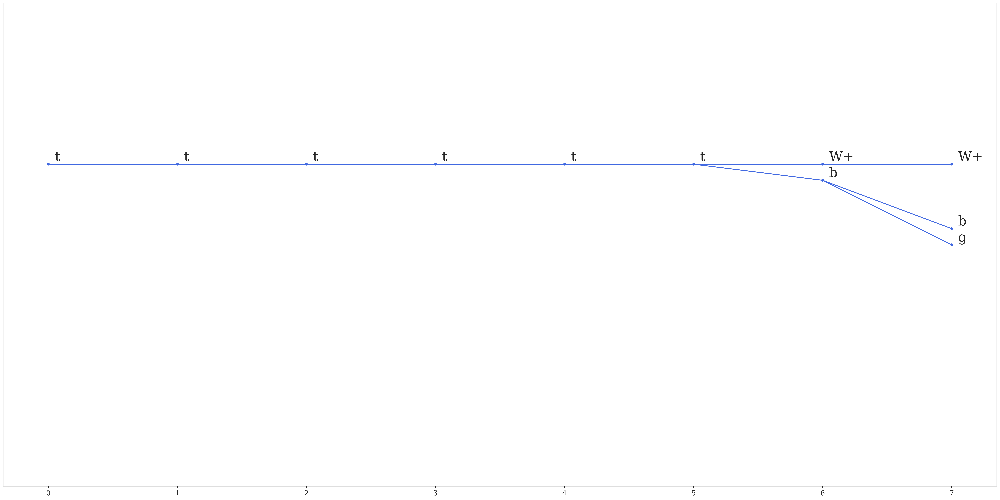

In [12]:
fig = plt.figure(figsize = [40,20], dpi = 300)
for i in range(8):
    if i == 0:
        plt.annotate(gen[i][i][3],(0.05+i,gen[i][i][1]+2), fontsize=30)
    else:
        for j,g in enumerate(gen[i]):
            mom_index = g[2]
            plt.plot([i-1,i],[gen[i-1][mom_index][1],g[1]],marker = 'o', color = 'royalblue',linewidth = 2)
            plt.annotate(g[3],(0.05+i,g[1]+2),fontsize=30)
            
#plt.yscale('log')
plt.tick_params(labelleft=False, left=False)
plt.savefig('parton_leveel.pdf')
plt.ylim([9800,10100])
plt.show()

In [19]:
for e in pylheV.readLHE('single_event.lhe'):
    gen1 = generationsWposition(e.particles,736,200,300)

In [21]:
fig = plt.figure(figsize = [40,70], dpi = 300)
for i in range(len(gen1)):
    if i == 0:
        plt.annotate(gen1[i][i][3],(0.05+i,gen1[i][i][1]+2), fontsize=30)
    else:
        for j,g in enumerate(gen1[i]):
            mom_index = g[2]
            plt.plot([i-1,i],[gen1[i-1][mom_index][1],g[1]],marker = 'o', color = 'royalblue',linewidth = 2)
            plt.annotate(g[3],(0.05+i,g[1]+2),fontsize=30)
            
#plt.yscale('log')
plt.tick_params(labelleft=False, left=False)
plt.savefig('quark_b.pdf')

plt.show()

In [45]:
for e in pylheV.readLHE('single_event.lhe'):
    gen3 = generationsWposition(e.particles,5,200,300)

In [49]:
fig = plt.figure(figsize = [40,100], dpi = 300)
for i in range(len(gen3)):
    if i == 0:
        plt.annotate(gen3[i][i][3],(0.05+i,gen3[i][i][1]+2), fontsize=30)
    else:
        for j,g in enumerate(gen3[i]):
            mom_index = g[2]
            plt.plot([i-1,i],[gen3[i-1][mom_index][1],g[1]],marker = 'o', color = 'royalblue',linewidth = 2)
            plt.annotate(g[3],(0.1+i,g[1]+10),fontsize=30)
            
#plt.yscale('log')
plt.tick_params(labelleft=False, left=False)
plt.savefig('all_event.pdf')
plt.show()